# Ptychography Tutorial 03

This is the third tutorial notebook in the iterative ptychography series.  
In this tutorial notebook we will cover:
- Parameter optimization

### Downloads
This tutorial uses the following datasets:
- [ptycho_ducky_simulation_03.h5](https://drive.google.com/file/d/1rCWIokqDGINpex_zYz4ryiiEkfuh1xTI/view?usp=drive_link)
- [ptycho_ducky_vacuum-probe_03.h5](https://drive.google.com/file/d/1aiZbsXU1dUf4RIHZDLUbWsGZlZZAaClM/view?usp=drive_link)

### Acknowledgements

This tutorial was created by the py4DSTEM `phase_contrast` team:
- Steven Zeltmann (steven.zeltmann@lbl.gov)
- Georgios Varnavides (gvarnavides@berkeley.edu)
- Stephanie Ribet (sribet@lbl.gov)
- Colin Ophus (clophus@lbl.gov)

Last updated 2024 May 3

## Parameter Optimization
We have already seen the importance of having accurate calibrations for phase retrieval, and investigated two powerful methods for obtaining good estimates:
- DPC: CoM curl minimization &rarr; rotation estimate
- Parallax: Cross-correlation shifts fitting &rarr; rotation, defocus, astigmatism etc estimates

There are however additional parameters, such as the reciprocal-space pixel-size, sample thickness (multi-slice) etc, which these methods don't inform us about and are of crucial importance to ptychographic reconstructions.

Here, we present a general framework to perform grid-search as-well as Bayesian inference optimization using Gaussian processes.

### Ducky Simulated Data
We'll investigate the optimizer using the simulated ducky dataset we've been looking at, where we know the true calibrations

In [1]:
import numpy as np
import py4DSTEM
import matplotlib.pyplot as plt

print(py4DSTEM.__version__)

cupyx.jit.rawkernel is experimental. The interface can change in the future.


0.14.18


In [2]:
path = 'C:\\_Data\\wendy_data\\'
file_data = path + 'al_alo_2_03_master.h5'
probe_path = path + 'al_alo_2_12_master.h5'
pt = path + 'pt_02_master.h5'

In [3]:
# py4DSTEM.save(data = dataset_masked, filepath= path + 'processed_al_alo_2_03_master.h5')
# py4DSTEM.save(data = probe_masked, filepath= path + 'processed_al_alo_2_12_master.h5')


In [83]:
# file_path = 'C:\\github\\py4DSTEM_tutorials\\data\\'
# file_data = file_path + 'ptycho_ducky_simulation_03.h5'
# file_probe = file_path + 'ptycho_ducky_vacuum-probe_03.h5'

dataset = py4DSTEM.import_file(pt,)
probe = py4DSTEM.import_file(probe_path)
dataset.calibration

# py4DSTEM.io.importfile.import_file


# dataset = py4DSTEM.io.importfile.import_file(file_data,)
# probe = py4DSTEM.io.importfile.import_file(probe_path)
# dataset.calibration

Dataset is uint32 but will be converted to uint16
Dataset is uint32 but will be converted to uint16


Calibration( A Metadata instance called 'calibration', containing the following fields:

             Q_pixel_size:    1
             R_pixel_size:    0.35634931937799036
             Q_pixel_units:   pixels
             R_pixel_units:   A
             QR_flip:         False
)

First, let's reproduce the reconstruction from the previous tutorial using the true calibration values.

In [84]:
q_pixel_size = 0.45449762893741413
q_pixel_unit = 'mrad'

r_pixel_size = 0.34555085515441486
r_pixel_unit = 'A'

In [85]:
for data in [dataset, probe,]:# pt_data]:
    data.calibration.set_Q_pixel_size(q_pixel_size)
    data.calibration.set_Q_pixel_units(q_pixel_unit)
    data.calibration.set_R_pixel_size(r_pixel_size)
    data.calibration.set_R_pixel_units(r_pixel_unit)

    data.get_dp_max()
    data.get_dp_mean()

In [86]:
dataset

DataCube( A 4-dimensional array of shape (256, 256, 192, 192) called 'datacube',
          with dimensions:

              Rx = [0.0,0.34555085515441486,0.6911017103088297,...] A
              Ry = [0.0,0.34555085515441486,0.6911017103088297,...] A
              Qx = [0.0,0.45449762893741413,0.9089952578748283,...] mrad
              Qy = [0.0,0.45449762893741413,0.9089952578748283,...] mrad
)

In [88]:
for dataset_1 in [dataset, probe]:#pt_data]:
    d = dataset_1.data
    print(np.max(d.data))
    print(np.min(d.data))
    print(d.data.shape)

65535
0
(256, 256, 192, 192)
65535
0
(16, 16, 192, 192)


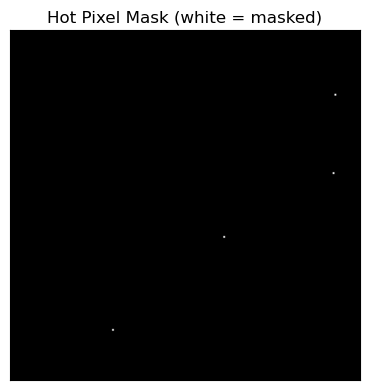

Maximum value 48


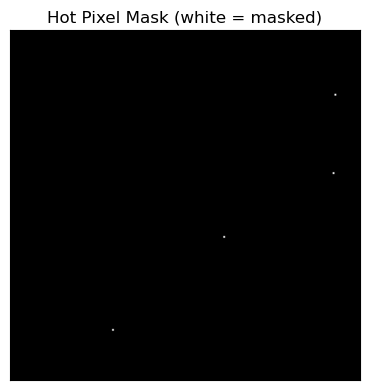

Maximum value 24


In [89]:
dataset_masked = []
for data in [dataset,probe,]:#pt_data]:
    mask_hotpixel = data.tree('dp_mean').data>100
    masked = data.median_filter_masked_pixels(mask = mask_hotpixel, kernel_width = 5)
    masked.get_dp_max();
    masked.get_dp_mean();
    # Plot the hot pixel mask
    py4DSTEM.show(
        mask_hotpixel,
        cmap='gray',
        figsize=(4,4),
        ticks=False,
        title='Hot Pixel Mask (white = masked)',
    )
    plt.show()
    dataset_masked.append(masked)
    print('Maximum value', np.max(masked.tree('dp_max').data))
dataset_masked, probe_masked = dataset_masked

In [90]:
for dataset_1 in [dataset_masked, probe_masked]:#pt_data]:
    d = dataset_1.data
    print(np.max(d.data))
    print(np.min(d.data))
    print(d.data.shape)

48
0
(256, 256, 192, 192)
24
0
(16, 16, 192, 192)


In [158]:
select_loc = 10
select_window = 50
data_partial = dataset_masked.data[select_loc:select_loc+select_window,select_loc:select_loc+select_window,:,:]

In [159]:
datacube_partial = py4DSTEM.DataCube(data = data_partial, calibration=dataset_masked.calibration)

A 'calibration' key already exists in root.metadata - overwriting...


In [160]:
py4DSTEM.save(
    data = datacube_partial,
    filepath = path + 'al_alo_sapph_master_partial2.h5',)

In [161]:
# import numpy as np

# has_nan = np.isnan(dataset_masked.data).any()
# has_inf = np.isinf(dataset_masked.data).any()

# print(f"Dataset contains NaN values: {has_nan}")
# print(f"Dataset contains Inf values: {has_inf}")

# if has_nan or has_inf:
#     print("Warning: Data is corrupt. Consider cleaning it, e.g., with np.nan_to_num.")
#     # my_dataset.data = np.nan_to_num(my_dataset.data) # Optional: cleans the data

In [162]:
# (probe_masked.tree('dp_mean').data*100).astype(np.uint64)

In [163]:
# dataset_masked_100 = py4DSTEM.datacube.DataCube(
#     data=(dataset_masked.data*100).astype(np.uint64),
#     calibration=dataset_masked.calibration,
#     name='Masked Dataset with 100 Data',
# )
# probe_masked_100 = py4DSTEM.datacube.DataCube(
#     data=(probe_masked.tree('dp_mean').data*100).astype(np.uint64),
#     calibration=probe_masked.calibration,
#     name='Masked Probe with 100 Data',
# )

In [164]:
# py4DSTEM.save(path+'dataset_masked_test.h5', dataset_masked)
# py4DSTEM.save(path+'probe_masked_test.h5', probe_masked)

In [165]:
# probe_masked.get_dp_mean()
# py4DSTEM.save(path+'probe_masked_dp_mean_test.h5', probe_masked.tree('dp_mean'))

In [166]:
# dataset = py4DSTEM.read(path+'dataset_masked_test.h5')
# probe = py4DSTEM.read(path+'probe_masked_test.h5')
# py4DSTEM.print_h5_tree(path+'probe_masked_test.h5')


In [167]:
# py4DSTEM.process.phase.MultislicePtychography(
#     datacube=dataset,
#     energy = 300e3,
#     defocus = 0,
#     vacuum_probe_intensity= probe.data,
#     verbose = True,
#     device = 'gpu',
#     storage = 'gpu',
#     num_slices = 5,
#     slice_thicknesses = 10,

# ).preprocess(
#     plot_center_of_mass= True,
#     plot_rotation= True,
#     plot_probe_overlaps=True,
# ).reconstruct(
    
# )

In [168]:
# !set CUPY_GPU_MEMORY_LIMIT=200 GB

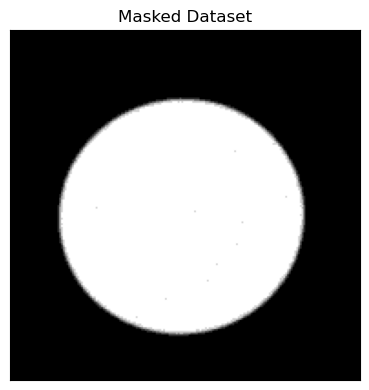

In [169]:
py4DSTEM.show(
    (probe_masked.tree('dp_mean').data).astype(np.uint16),
    cmap='gray',
    figsize=(4,4),
    ticks=False,
    title='Masked Dataset',
)

In [22]:
import cupy as cp
from cupy.fft.config import get_plan_cache

mempool = cp.get_default_memory_pool()
pinned_mempool = cp.get_default_pinned_memory_pool()
cache = get_plan_cache()
def release_class_gpu_memory(clear_fft_cache = True):

    if clear_fft_cache is True:
        cache.clear()
        
    mempool.free_all_blocks()
    pinned_mempool.free_all_blocks()

In [23]:
release_class_gpu_memory()

In [15]:
probe_nparray = (probe_masked.tree('dp_mean').data)

Best fit rotation = -15 degrees.
Normalizing amplitudes: 100%|██████████| 2500/2500 [00:07<00:00, 352.45probe position/s]
Performing 64 iterations using a complex object type, with the gradient-descent algorithm, with normalization_min: 1 and step_size: 0.5, in batches of max 512 measurements.
Reconstructing object and probe: 100%|██████████| 64/64 [00:17<00:00,  3.70 iter/s]
Best fit rotation = -15 degrees.
Normalizing amplitudes: 100%|██████████| 2500/2500 [00:07<00:00, 350.93probe position/s]
Performing 64 iterations using a complex object type, with the gradient-descent algorithm, with normalization_min: 1 and step_size: 0.5, in batches of max 512 measurements.
Reconstructing object and probe: 100%|██████████| 64/64 [00:17<00:00,  3.72 iter/s]
Best fit rotation = -15 degrees.
Normalizing amplitudes: 100%|██████████| 2500/2500 [00:07<00:00, 352.13probe position/s]
Performing 64 iterations using a complex object type, with the gradient-descent algorithm, with normalization_min: 1 and

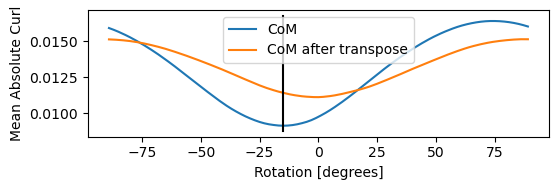

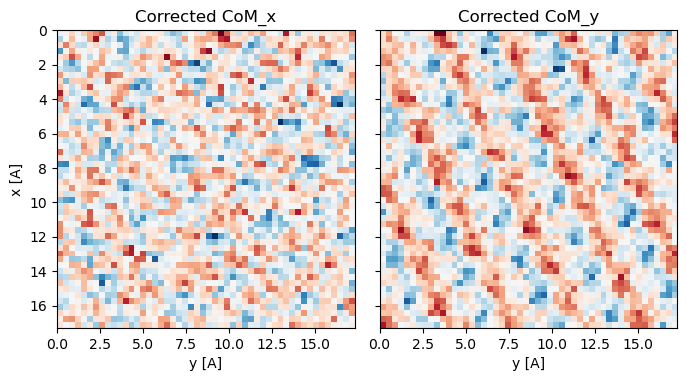

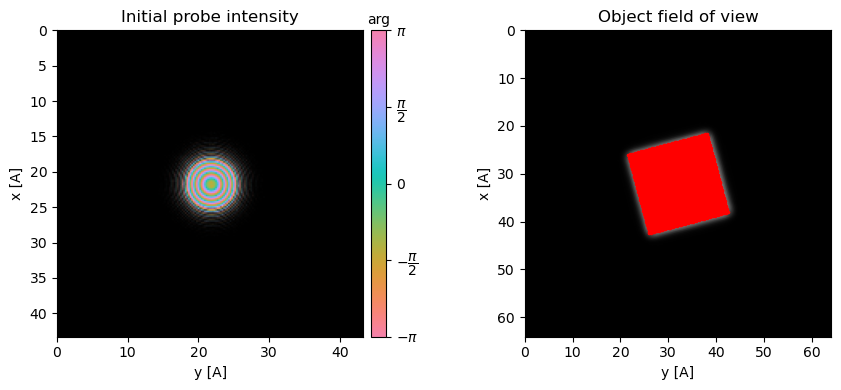

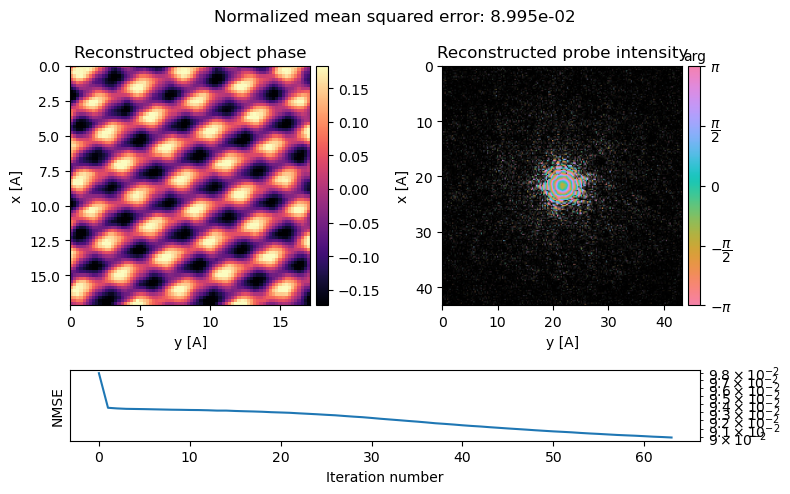

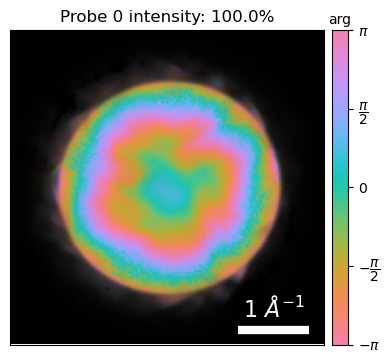

...

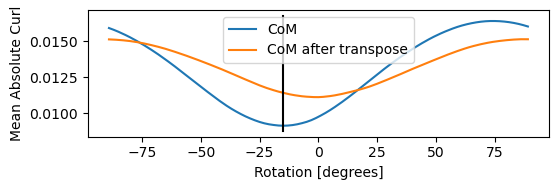

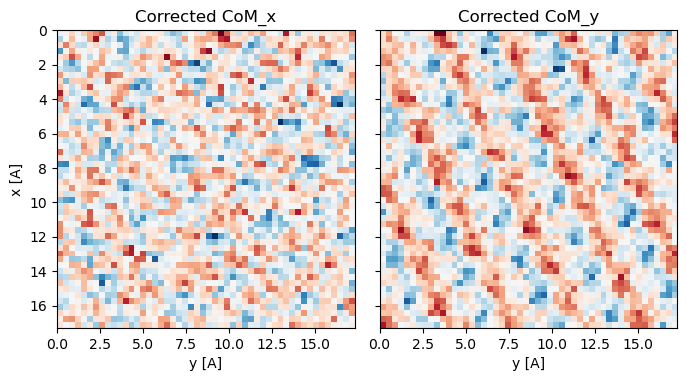

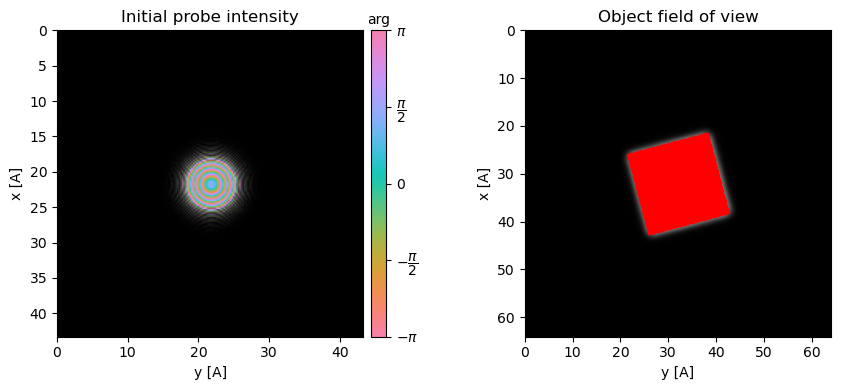

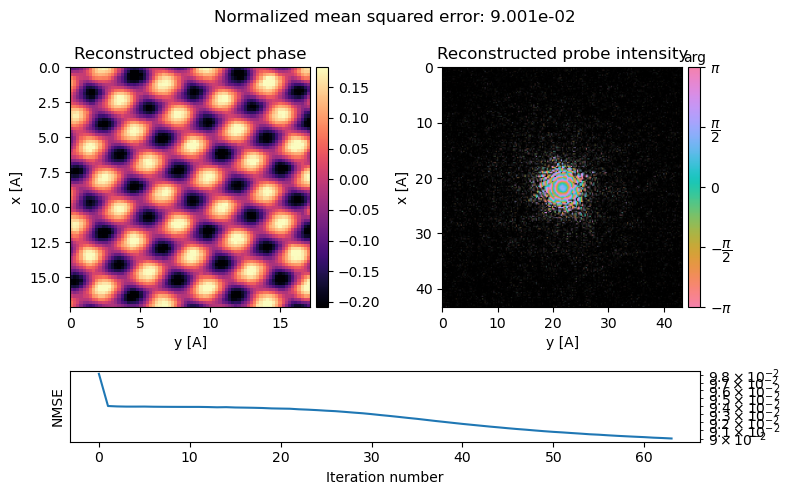

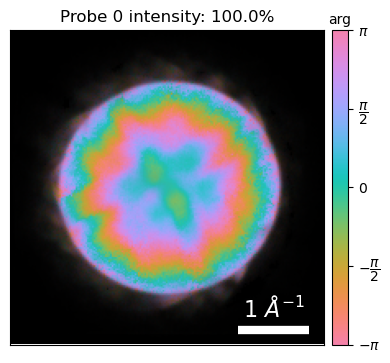

In [170]:
ptychos_sweep_roll = []
ptychos_object = []
ptychos_object_fft = []

sweep_param = np.linspace(-60,60,5)

for roll in sweep_param:   
    ptycho1 = py4DSTEM.process.phase.SingleslicePtychography(
        datacube=datacube_partial,
        energy=300e3,
        defocus=roll,
        vacuum_probe_intensity=probe_nparray,
        verbose=True,
        device='gpu', # uncomment if you have access to a GPU
        storage='cpu', # uncomment if you have access to a GPU
        semiangle_cutoff = 30,
    )

    ptycho = ptycho1.preprocess(
        plot_rotation=True,
        plot_center_of_mass = True,
        plot_probe_overlaps = True,
        # vectorized_com_calculation = False, # disable default CoM vectorized calc
        # store_initial_arrays= False, # don't store arrays necessary for reset=True
        max_batch_size= 128, # set max batch size for GPU memory
        clear_fft_cache=True, # clear the FFT cache to free GPU memory
    )
    ptycho00 = ptycho.reconstruct(
        num_iter = 64,
        seed_random=0,
        max_batch_size=512,
    ).visualize(
    )
    ptycho.show_fourier_probe()

    ptychos_sweep_roll.append(ptycho00)

    ptychos_object.append( np.angle(ptycho00.object_cropped).copy())
    ptychos_object_fft.append(ptycho00.object_fft)

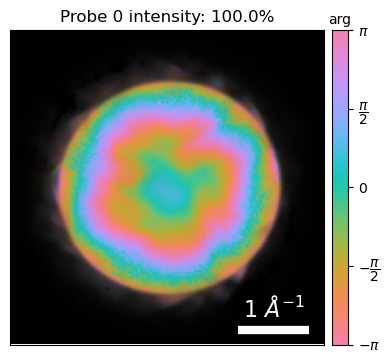

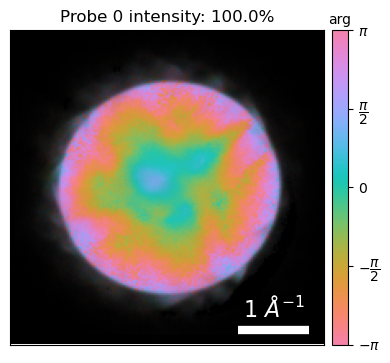

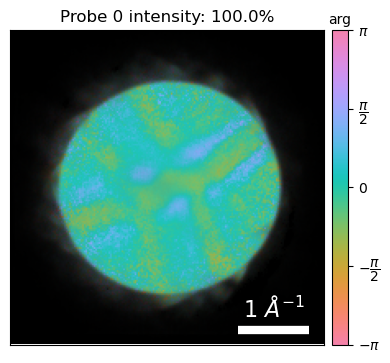

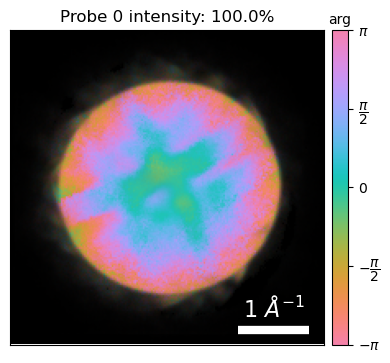

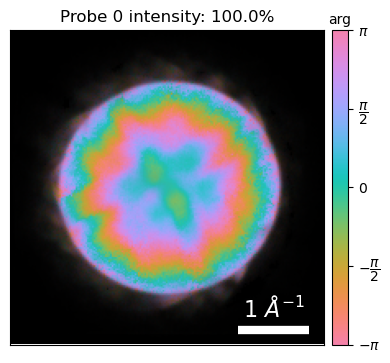

In [172]:
probe_intensities = []
probe_images = []
for i, p in enumerate(ptychos_sweep_roll):
    probe_intensity = np.abs(p.probe.copy())
    probe_intensities.append(probe_intensity)

    p.show_fourier_probe()
    plt.savefig(f'test_probe{i}.png', dpi=300, bbox_inches='tight')

    probe_images.append(plt.imread(f'test_probe{i}.png'))

    # py4DSTEM.show(
    #     probe_intensity
    # )

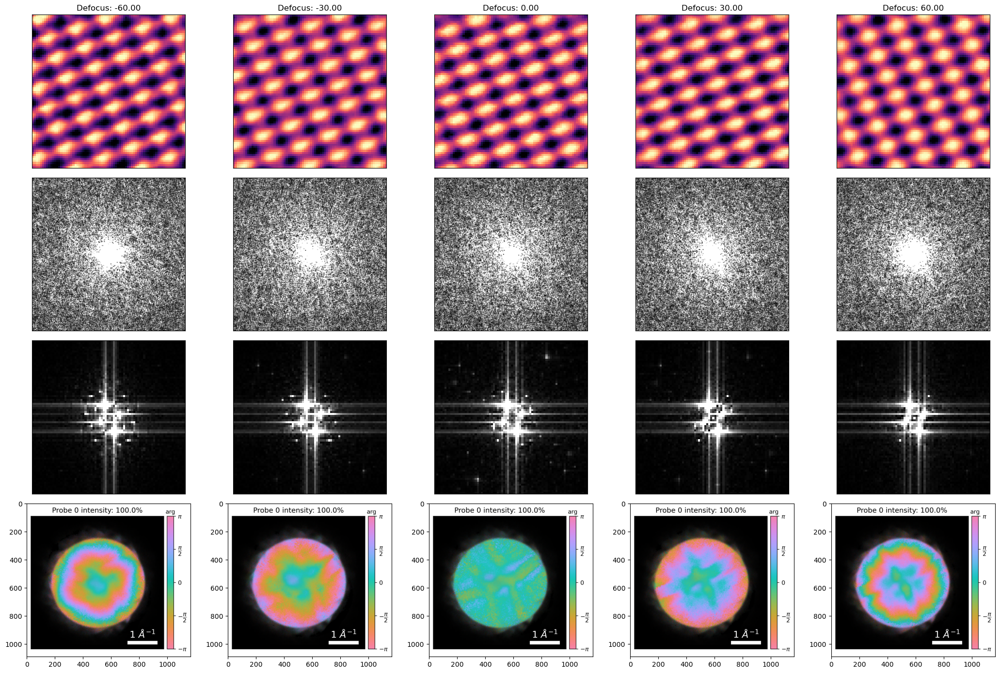

In [173]:
fig, axs = plt.subplots(4,len(ptychos_object),figsize=(3.5*6,3.5*4))
sweep_param_name = 'Defocus'

titles = []
for i, roll in enumerate(sweep_param):
    titles.append(f"{sweep_param_name}: {roll:.2f}")

py4DSTEM.show(
    ptychos_object,
    ticks=False,
    figax=(fig,axs[0]),
    cmap='magma',
    title=titles,
)

py4DSTEM.show(
    probe_intensities,
    ticks=False,
    figax=(fig,axs[1]),
    vmin=0.001,
    vmax=0.899,
)
py4DSTEM.show(
    ptychos_object_fft,
    ticks=False,
    figax=(fig,axs[2]),
)

for i, ax in enumerate(axs[3]):
    ax.imshow(probe_images[i])

fig.tight_layout()
fig.savefig(f'C:\\github\\py4DSTEM_tutorials\\data\\ptycho_sweep_{sweep_param_name}_fine_big_area.png', dpi=300, bbox_inches='tight')

Best fit rotation = -13 degrees.
Normalizing amplitudes: 100%|██████████| 900/900 [00:02<00:00, 349.95probe position/s]
Performing 64 iterations using a complex object type, with the gradient-descent algorithm, with normalization_min: 1 and step_size: 0.5, in batches of max 512 measurements.
Reconstructing object and probe: 100%|██████████| 64/64 [00:22<00:00,  2.82 iter/s]
Best fit rotation = -13 degrees.
Normalizing amplitudes: 100%|██████████| 900/900 [00:02<00:00, 349.30probe position/s]
Performing 64 iterations using a complex object type, with the gradient-descent algorithm, with normalization_min: 1 and step_size: 0.5, in batches of max 512 measurements.
Reconstructing object and probe: 100%|██████████| 64/64 [00:13<00:00,  4.75 iter/s]
Best fit rotation = -13 degrees.
Normalizing amplitudes: 100%|██████████| 900/900 [00:02<00:00, 351.17probe position/s]
Performing 64 iterations using a complex object type, with the gradient-descent algorithm, with normalization_min: 1 and step_

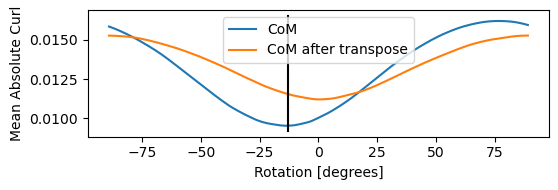

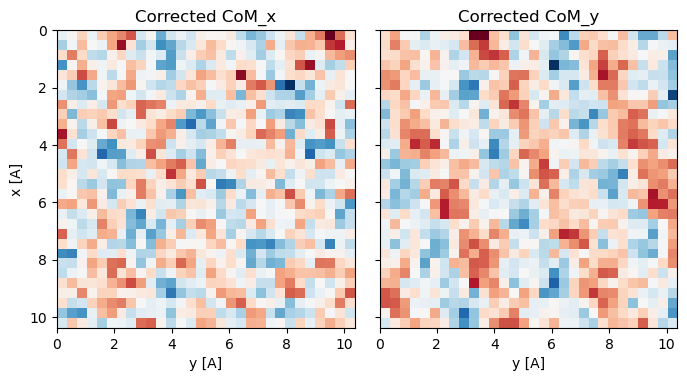

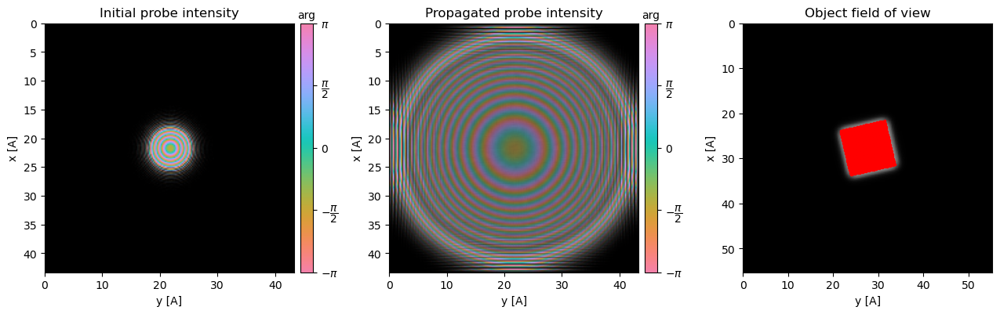

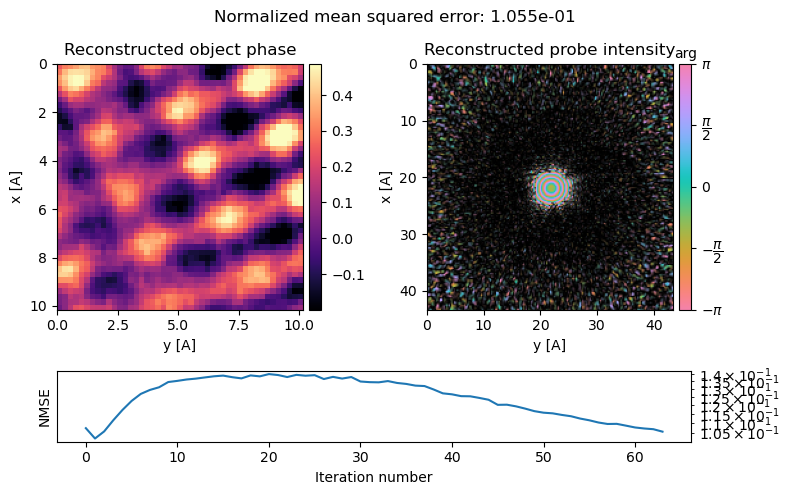

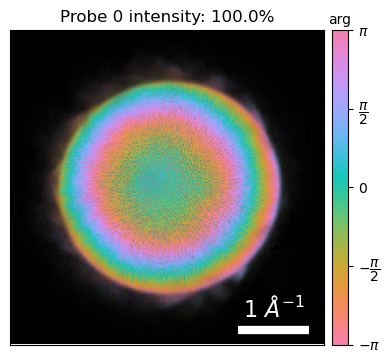

...

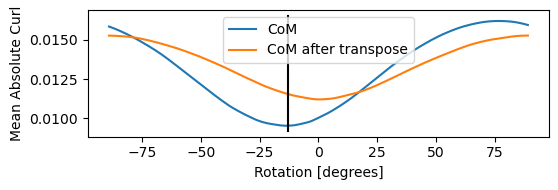

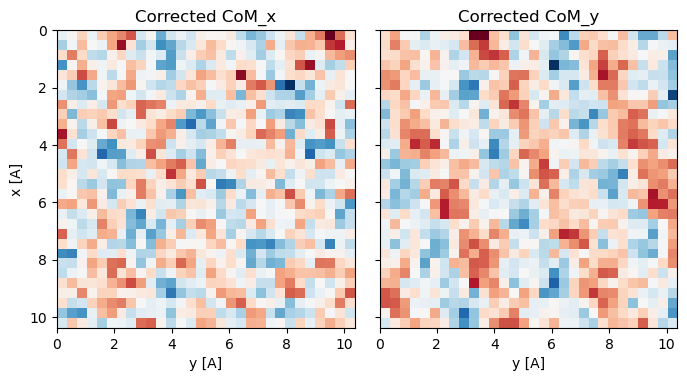

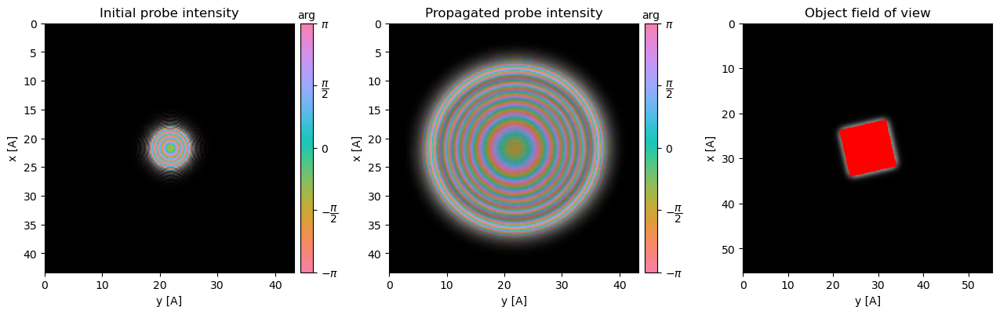

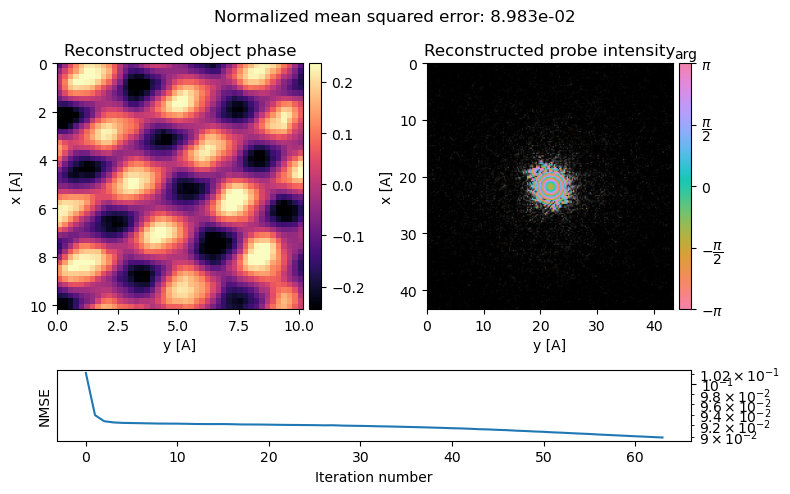

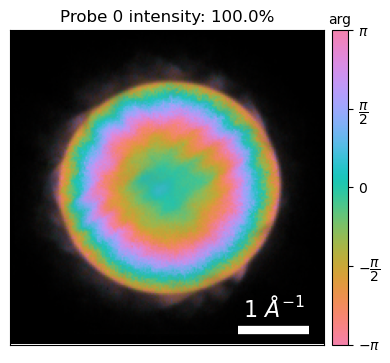

In [151]:
ptychos_sweep_roll = []
ptychos_object = []
ptychos_object_fft = []

sweep_param = np.arange(100,501,100)
tot_thickness = 750

for roll in sweep_param:    
    ptycho1 = py4DSTEM.process.phase.MultislicePtychography(
        datacube=datacube_partial,
        energy=300e3,
        defocus=-60,
        vacuum_probe_intensity=probe_nparray,
        verbose=True,
        device='gpu', # uncomment if you have access to a GPU
        storage='cpu', # uncomment if you have access to a GPU
        semiangle_cutoff = 30,
        num_slices = tot_thickness // roll + 1, # number of slices
        slice_thicknesses = roll,
    )

    ptycho = ptycho1.preprocess(
        plot_rotation=True,
        plot_center_of_mass = True,
        plot_probe_overlaps = True,
        # vectorized_com_calculation = False, # disable default CoM vectorized calc
        # store_initial_arrays= False, # don't store arrays necessary for reset=True
        max_batch_size= 216, # set max batch size for GPU memory
        clear_fft_cache=True, # clear the FFT cache to free GPU memory
    )
    ptycho00 = ptycho.reconstruct(
        num_iter = 64,
        seed_random=0,
        max_batch_size=512,
    ).visualize(
    )
    ptycho.show_fourier_probe()

    ptychos_sweep_roll.append(ptycho00)

    ptychos_object.append(np.average(np.angle(ptycho00.object_cropped).copy(), axis = 0))
    ptychos_object_fft.append(ptycho00.object_fft)

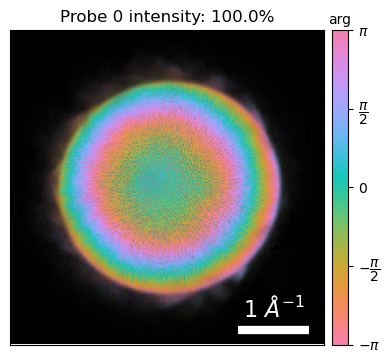

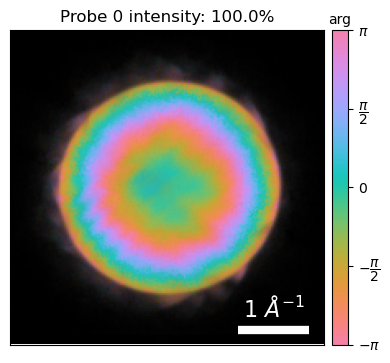

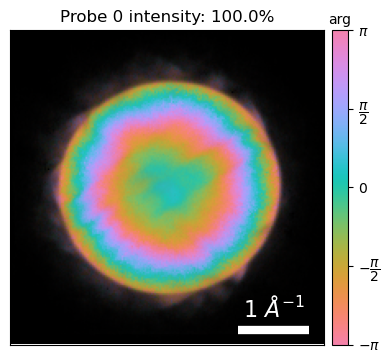

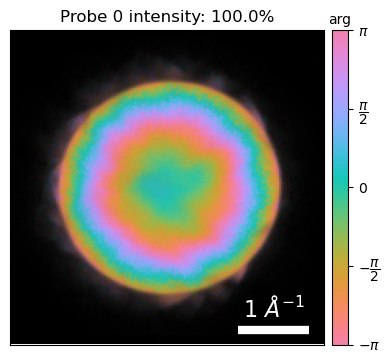

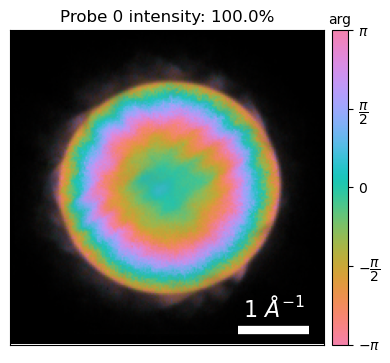

In [152]:
probe_intensities = []
probe_images = []
for i, p in enumerate(ptychos_sweep_roll):
    probe_intensity = np.abs(p.probe.copy())
    probe_intensities.append(probe_intensity)

    p.show_fourier_probe()
    plt.savefig(f'test_probe{i}.png', dpi=300, bbox_inches='tight')

    probe_images.append(plt.imread(f'test_probe{i}.png'))

    # py4DSTEM.show(
    #     probe_intensity
    # )

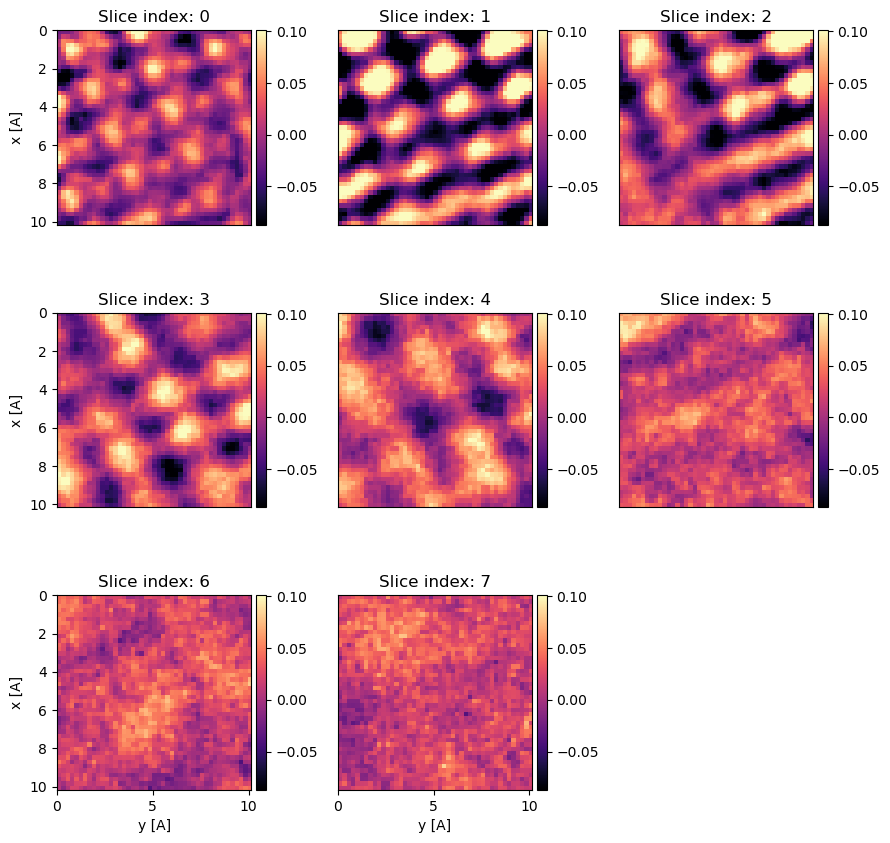

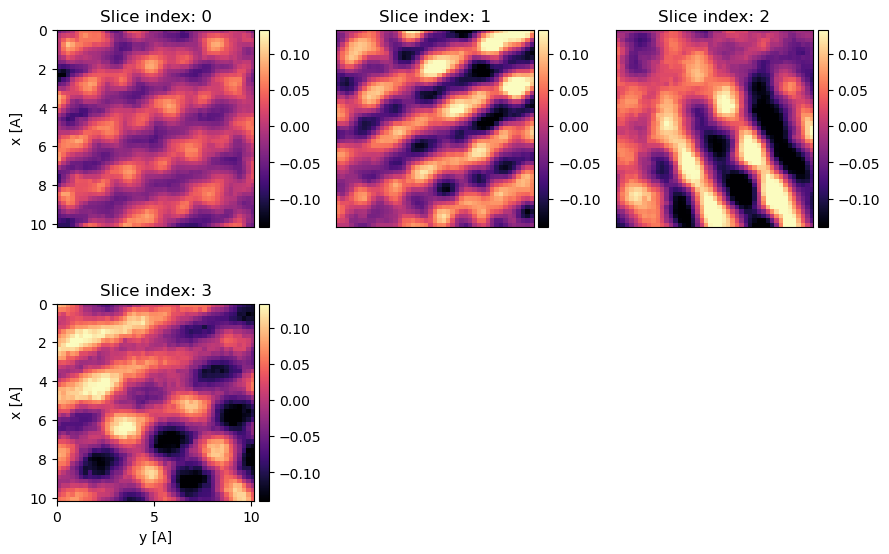

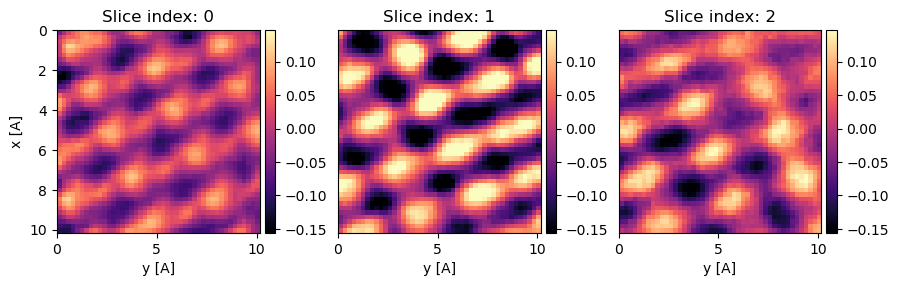

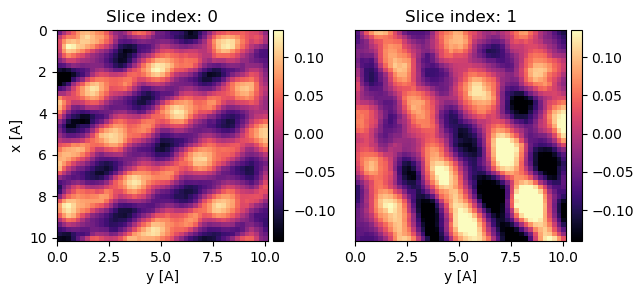

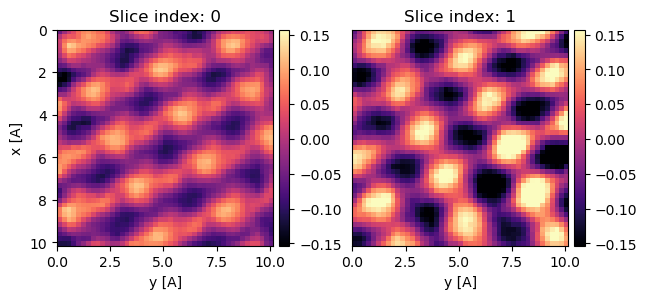

In [153]:
for i,p in enumerate(ptychos_sweep_roll):
    p.show_slices()
    plt.savefig(f'test_750nm_slices_{sweep_param[i]:.2f}nm.png', dpi=300, bbox_inches='tight')

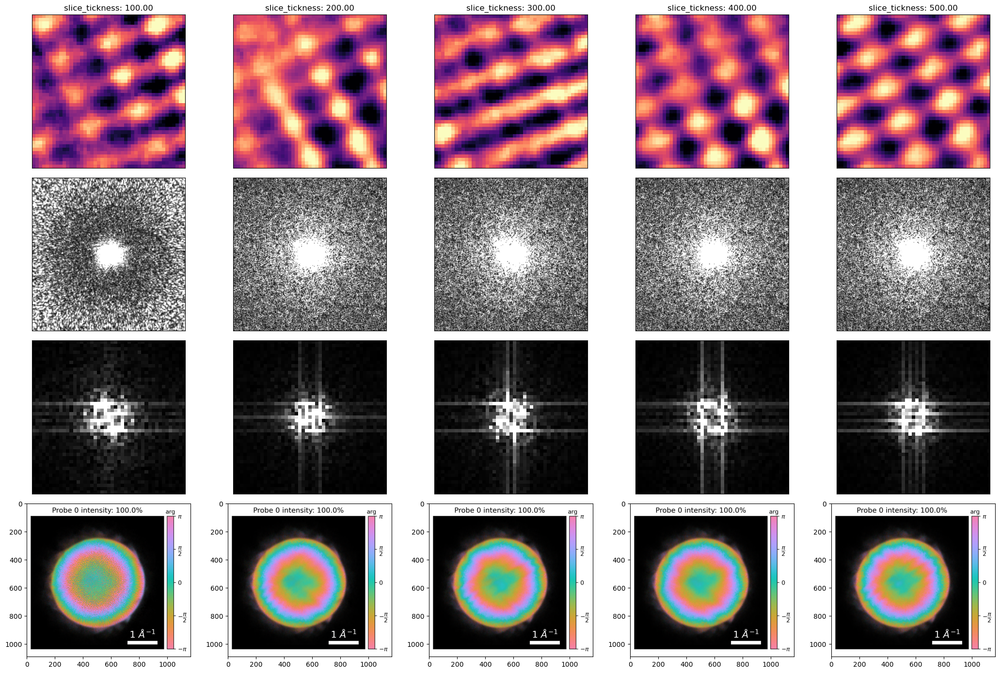

In [157]:
fig, axs = plt.subplots(4,len(ptychos_object),figsize=(3.5*6,3.5*4))
sweep_param_name = 'slice_tickness'

titles = []
for i, roll in enumerate(sweep_param):
    titles.append(f"{sweep_param_name}: {roll:.2f}")

py4DSTEM.show(
    ptychos_object,
    ticks=False,
    figax=(fig,axs[0]),
    cmap='magma',
    title=titles,
)

py4DSTEM.show(
    probe_intensities,
    ticks=False,
    figax=(fig,axs[1]),
    vmin=0.001,
    vmax=0.899,
)
py4DSTEM.show(
    ptychos_object_fft,
    ticks=False,
    figax=(fig,axs[2]),
)

for i, ax in enumerate(axs[3]):
    ax.imshow(probe_images[i])

fig.tight_layout()
fig.savefig(f'C:\\github\\py4DSTEM_tutorials\\data\\ptycho_sweep_tot750nm_{sweep_param_name}.png', dpi=300, bbox_inches='tight')

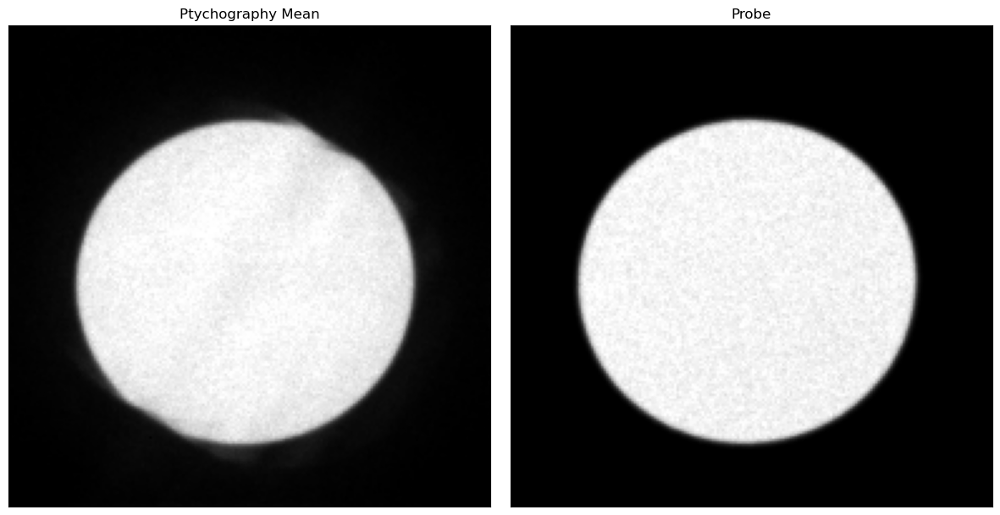

In [ ]:
datacube_partial.get_dp_mean()
py4DSTEM.show(
    [
        datacube_partial.tree('dp_mean').data,
        probe_masked.tree('dp_mean').data,
    ],
    cmap='gray',
    figsize=(4,4),
    ticks=False,
    title=['Ptychography Mean', 'Probe']
)

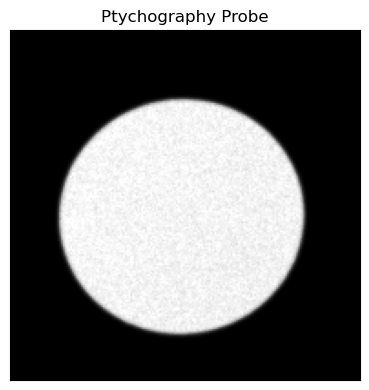

In [ ]:
py4DSTEM.show(
    probe_nparray,
    cmap='gray',
    figsize=(4,4),
    ticks=False,
    title='Ptychography Probe',

)

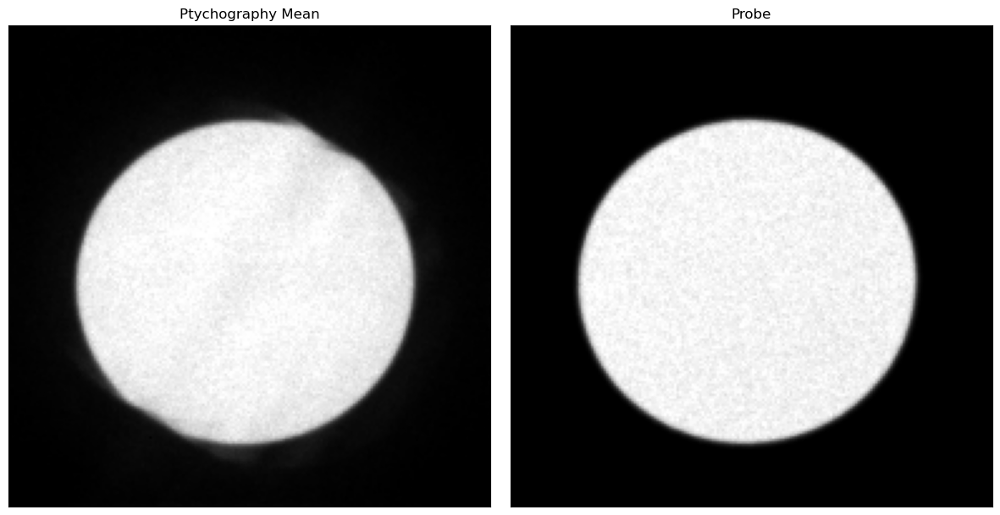

In [41]:
datacube_partial.get_dp_mean()
py4DSTEM.show(
    [
        datacube_partial.tree('dp_mean').data,
        probe_masked.tree('dp_mean').data,
    ],
    cmap='gray',
    figsize=(4,4),
    ticks=False,
    title=['Ptychography Mean', 'Probe']
)

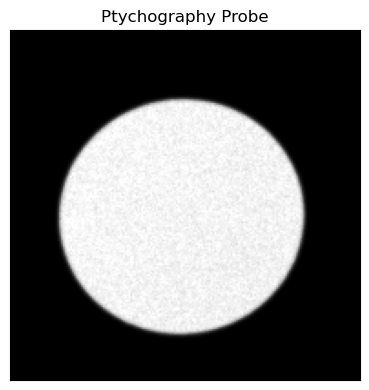

In [21]:
py4DSTEM.show(
    probe_nparray,
    cmap='gray',
    figsize=(4,4),
    ticks=False,
    title='Ptychography Probe',

)

And investigate how the reconstruction quality degrades if one of rotation, defocus, reciprocal-space calibration is off by 15%

In [31]:
import cupy as cp
from cupy.fft.config import get_plan_cache
mempool = cp.get_default_memory_pool()
pinned_mempool = cp.get_default_pinned_memory_pool()
cache = get_plan_cache()

def report_class_gpu_memory_usage(cls):

    size_on_device = 0
    for att in sorted(cls.__dict__):
        attr = getattr(cls,att)
        
        if isinstance(attr,(np.ndarray,cp.ndarray)):
            
            if get_array_module(attr) is not np:
                size_on_device += attr.nbytes
                print(f"Attribute {att}: {attr.nbytes*1e-3:.3f}Kb")
    
        if isinstance(attr,list) and isinstance(attr[0],(np.ndarray,cp.ndarray)):
            
            size_entering_loop = size_on_device
            for el in attr:
                if get_array_module(el) is not np:
                    size_on_device += el.nbytes
                    
            print(f"Attribute {att}: {(size_on_device-size_entering_loop)*1e-3:.3f}Kb")
    
    print(f"\nEstimated size on device: {size_on_device*1e-6:.3f}Mb")
    print(f"Reported size on device: {mempool.used_bytes()*1e-6:.3f}Mb")
    
    return None

def release_class_gpu_memory(clear_fft_cache = True):

    if clear_fft_cache is True:
        cache.clear()
        
    mempool.free_all_blocks()
    pinned_mempool.free_all_blocks()

    return None

cache.set_size(0)

In [37]:
release_class_gpu_memory()

Calculating center of mass: 100%|██████████| 65536/65536 [00:19<00:00, 3340.40probe position/s]
Best fit rotation = -4 degrees.
Normalizing amplitudes: 100%|██████████| 65536/65536 [03:05<00:00, 354.13probe position/s]
Performing 64 iterations using a complex object type, with the gradient-descent algorithm, with normalization_min: 1 and step_size: 0.5, in batches of max 512 measurements.
Reconstructing object and probe: 100%|██████████| 64/64 [15:31<00:00, 14.55s/ iter]


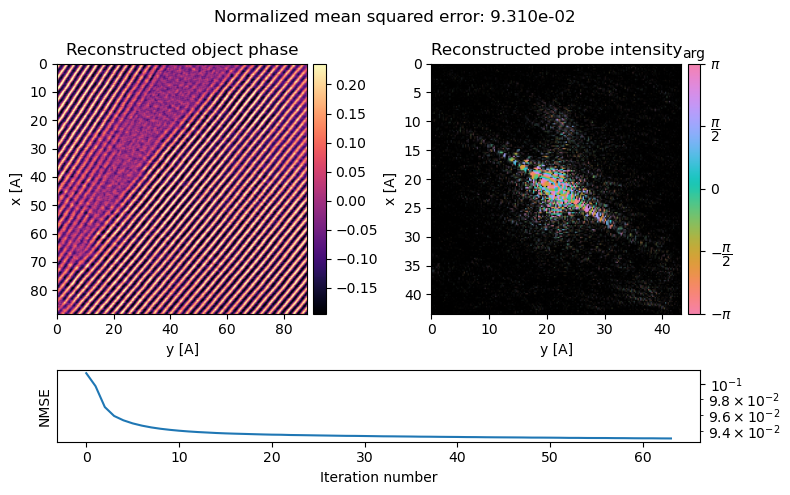

In [22]:
mptycho_01 = py4DSTEM.process.phase.MultislicePtychography(
    energy=300e3,
    num_slices=4,
    semiangle_cutoff = 200,
    slice_thicknesses=20,
    datacube=dataset_masked,
    defocus=0,
    vacuum_probe_intensity=probe_nparray*10,
    verbose=True,
    device='gpu', # uncomment if you have access to a GPU
    storage='cpu', # uncomment if you have access to a GPU
)

mptycho = mptycho_01.preprocess(
    plot_center_of_mass = False,
    plot_rotation=False,
    plot_probe_overlaps=False,
    vectorized_com_calculation = False, # disable default CoM vectorized calc
    store_initial_arrays= False, # don't store arrays necessary for reset=True
).reconstruct(
    num_iter = 64,
    seed_random=0,
    max_batch_size=512,
).visualize(
)


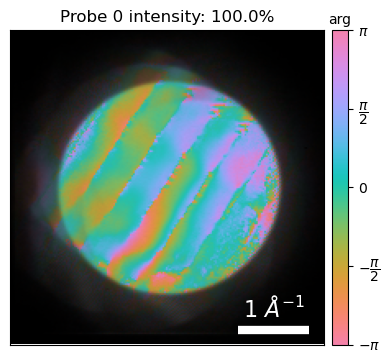

In [23]:
mptycho.show_fourier_probe()

Calculating center of mass: 100%|██████████| 65536/65536 [00:19<00:00, 3335.38probe position/s]
Best fit rotation = -4 degrees.
Normalizing amplitudes: 100%|██████████| 65536/65536 [03:06<00:00, 351.32probe position/s]
Performing 64 iterations using a complex object type, with the gradient-descent algorithm, with normalization_min: 1 and step_size: 0.5.
Reconstructing object and probe:   0%|          | 0/64 [00:50<?, ? iter/s]


OutOfMemoryError: Out of memory allocating 38,654,705,664 bytes (allocated so far: 106,422,131,712 bytes).

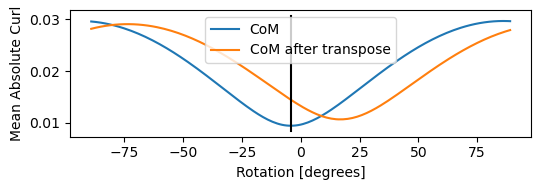

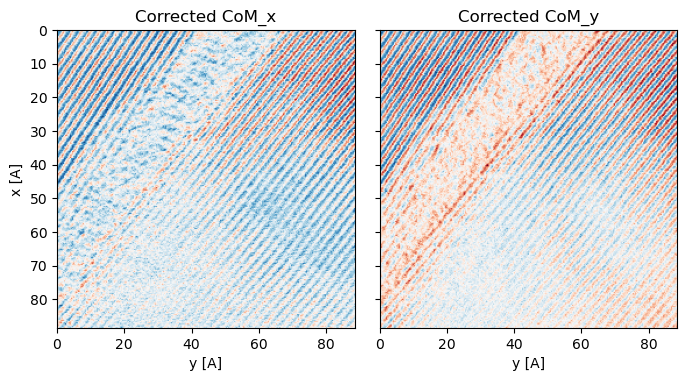

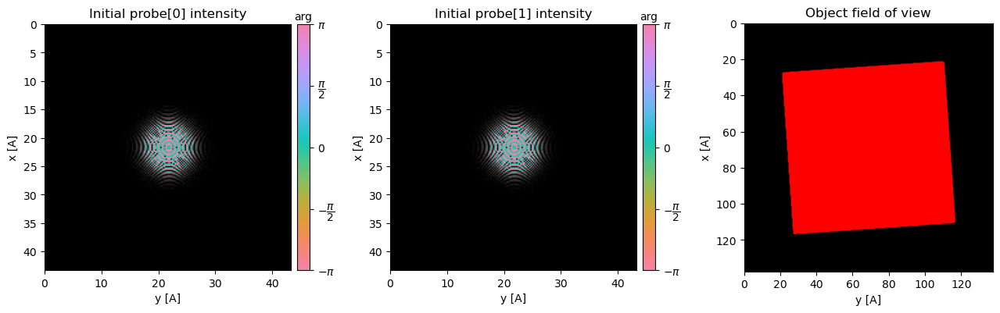

In [ ]:
ptycho_01_mixed = py4DSTEM.process.phase.MixedstatePtychography(
    datacube=dataset_masked,
    energy=300e3,
    defocus=0,
    vacuum_probe_intensity= probe_nparray,
    verbose=True,
    num_probes=2,
    device='gpu', # uncomment if you have access to a GPU
    storage='cpu', # uncomment if you have access to a GPU
    semiangle_cutoff=30,
)


Calculating center of mass: 100%|██████████| 65536/65536 [00:21<00:00, 3052.07probe position/s]
Best fit rotation = -4 degrees.
Normalizing amplitudes: 100%|██████████| 65536/65536 [03:07<00:00, 349.51probe position/s]
Performing 64 iterations using a complex object type, with the gradient-descent algorithm, with normalization_min: 1 and step_size: 0.5, in batches of max 512 measurements.
Reconstructing object and probe: 100%|██████████| 64/64 [09:38<00:00,  9.04s/ iter]


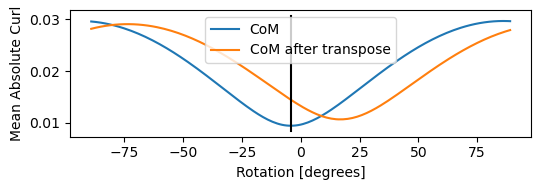

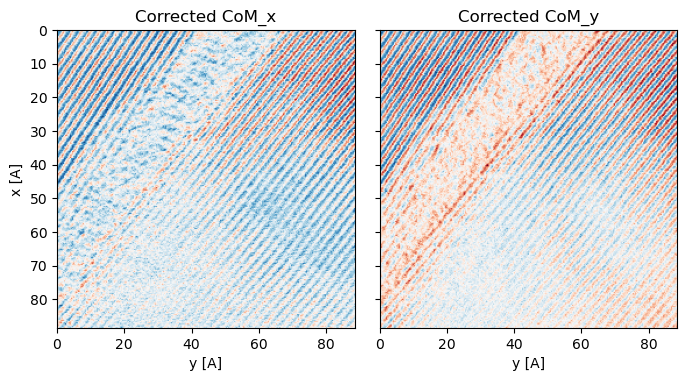

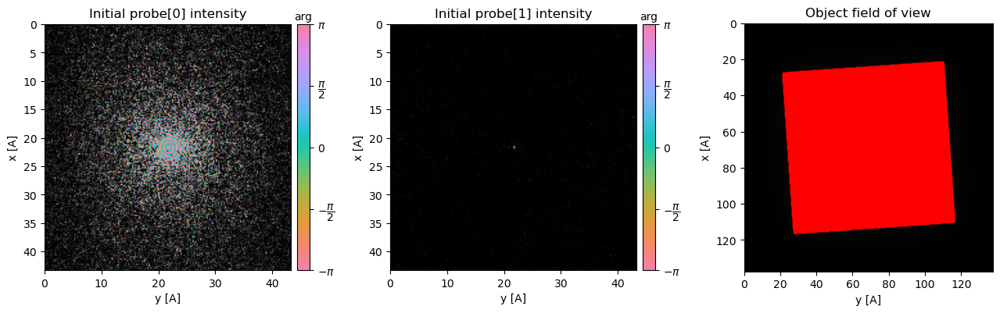

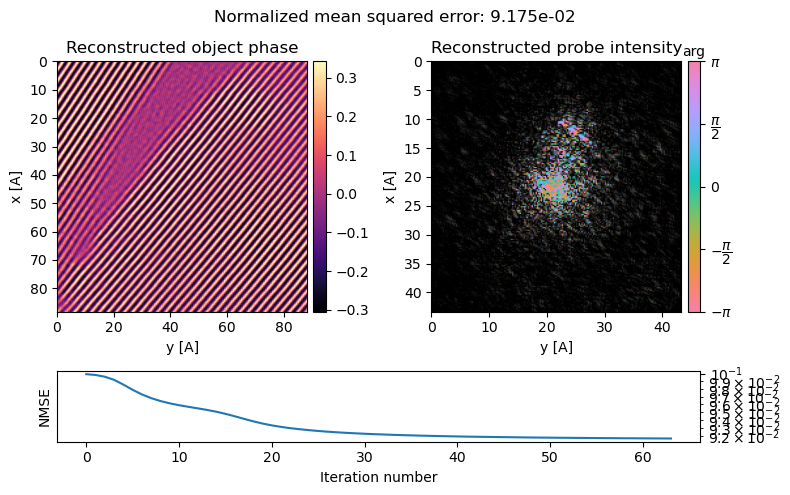

In [27]:
ptycho_mixed = ptycho_01_mixed.preprocess(
    plot_center_of_mass = True,
    plot_rotation=True,
    plot_probe_overlaps=True,
    vectorized_com_calculation = False, # disable default CoM vectorized calc
    store_initial_arrays= False, # don't store arrays necessary for reset=True
    max_batch_size= 128, # set max batch size for GPU memory
)

ptycho_mixed_00 = ptycho_mixed.reconstruct(
    num_iter = 64,
    seed_random=2024,
    max_batch_size=512,
).visualize(
)

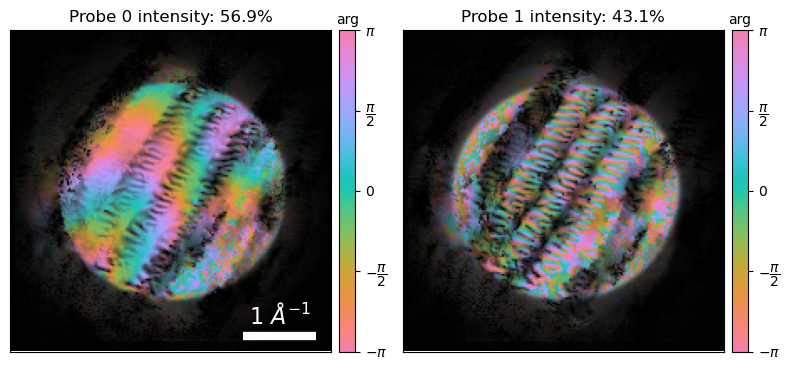

In [28]:
ptycho_mixed.show_fourier_probe()

In [ ]:
mptycho

In [39]:
# try:
#     for i in range(10):
#         release_class_gpu_memory()
# except:
#     for i in range(10):
#         release_class_gpu_memory()

mptycho_computational_intense = py4DSTEM.process.phase.SingleslicePtychography(
    datacube=dataset_masked,
    energy=300e3,
    defocus=0,
    vacuum_probe_intensity=probe_nparray,
    verbose=True,
    device='gpu', # uncomment if you have access to a GPU
    storage='cpu', # uncomment if you have access to a GPU
).preprocess(
    plot_center_of_mass = True,
    plot_rotation=True,
    plot_probe_overlaps=True,
    vectorized_com_calculation = False, # disable default CoM vectorized calc
    store_initial_arrays= False, # don't store arrays necessary for reset=True
).reconstruct(
    num_iter = 64,
    seed_random=0,
    max_batch_size=512,
).visualize(
)

CUDADriverError: CUDA_ERROR_UNKNOWN: unknown error

Calculating center of mass: 100%|██████████| 65536/65536 [00:19<00:00, 3356.34probe position/s]
Best fit rotation = -4 degrees.
Normalizing amplitudes: 100%|██████████| 65536/65536 [03:06<00:00, 350.84probe position/s]
Performing 64 iterations using a complex object type, with the gradient-descent algorithm, with normalization_min: 1 and step_size: 0.5, in batches of max 512 measurements.
Reconstructing object and probe: 100%|██████████| 64/64 [18:08<00:00, 17.00s/ iter]


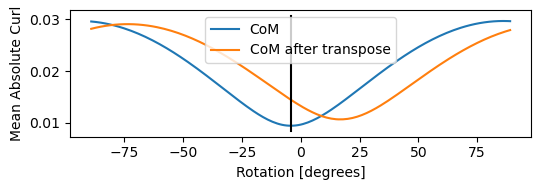

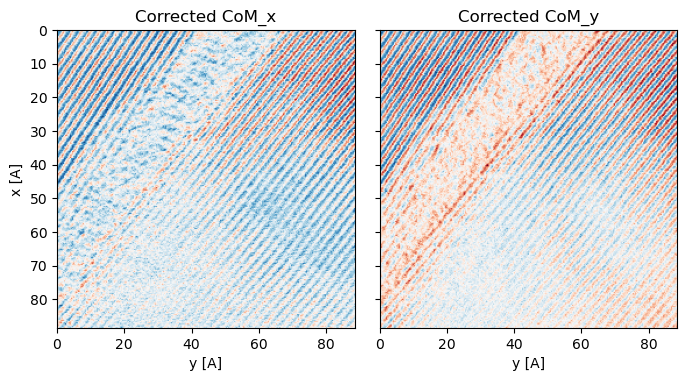

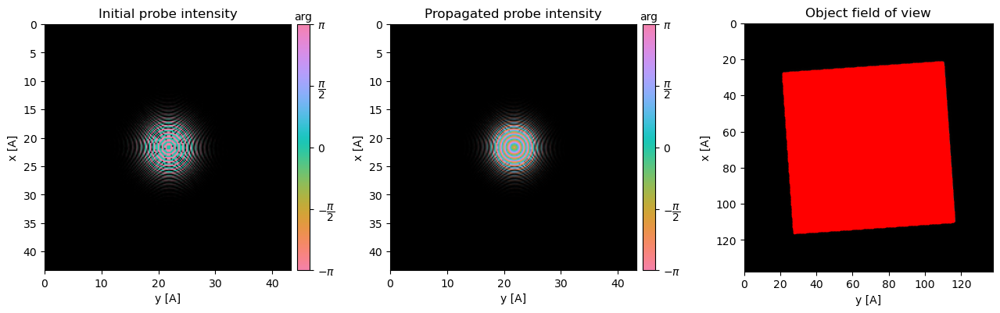

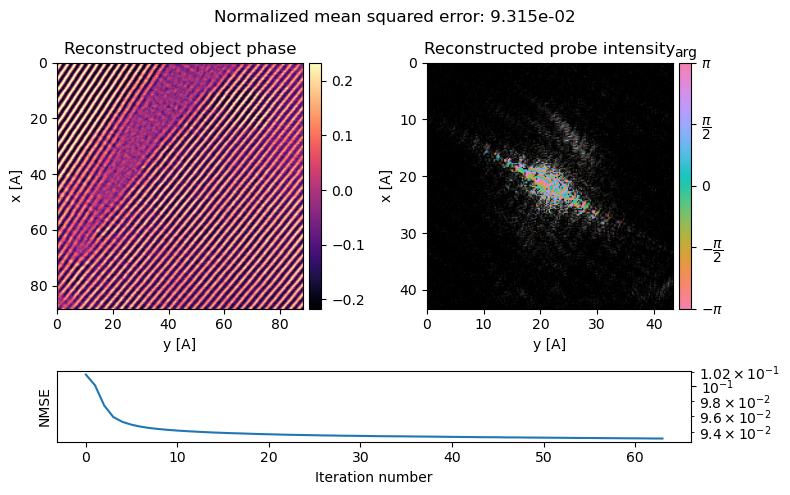

In [ ]:
mptycho_intense = py4DSTEM.process.phase.MultislicePtychography(
    energy=300e3,
    num_slices=5,
    slice_thicknesses=10,
    datacube=dataset_masked,
    defocus=0,
    vacuum_probe_intensity=probe_nparray,
    verbose=True,
    device='gpu', # uncomment if you have access to a GPU
    storage='cpu', # uncomment if you have access to a GPU
).preprocess(
    plot_center_of_mass = True,
    plot_rotation=True,
    plot_probe_overlaps=True,
    vectorized_com_calculation = False, # disable default CoM vectorized calc
    store_initial_arrays= False, # don't store arrays necessary for reset=True
).reconstruct(
    num_iter = 64,
    seed_random=0,
    max_batch_size=512,
).visualize(
)

Calculating center of mass: 100%|██████████| 65536/65536 [00:19<00:00, 3360.91probe position/s]
Best fit rotation = -4 degrees.
Normalizing amplitudes: 100%|██████████| 65536/65536 [03:06<00:00, 350.86probe position/s]
Performing 64 iterations using a complex object type, with the gradient-descent algorithm, with normalization_min: 1 and step_size: 0.5, in batches of max 512 measurements.
Reconstructing object and probe: 100%|██████████| 64/64 [07:09<00:00,  6.71s/ iter]


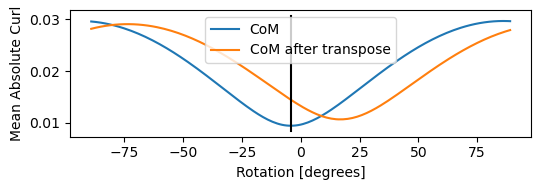

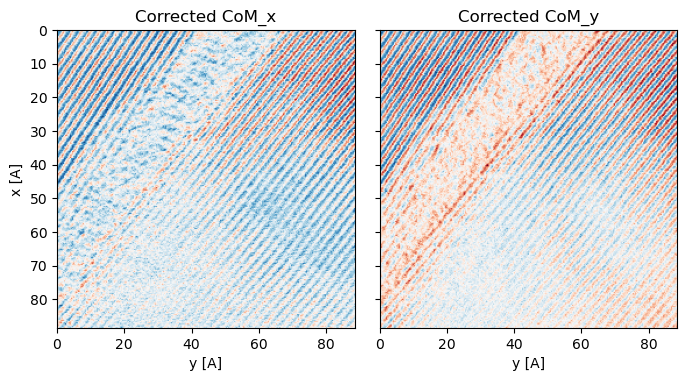

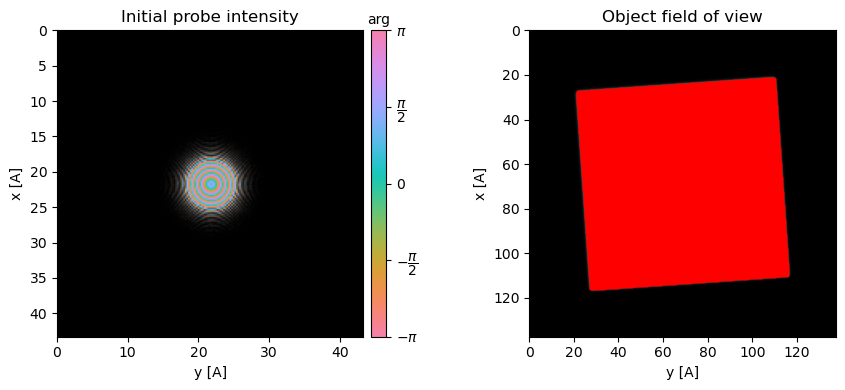

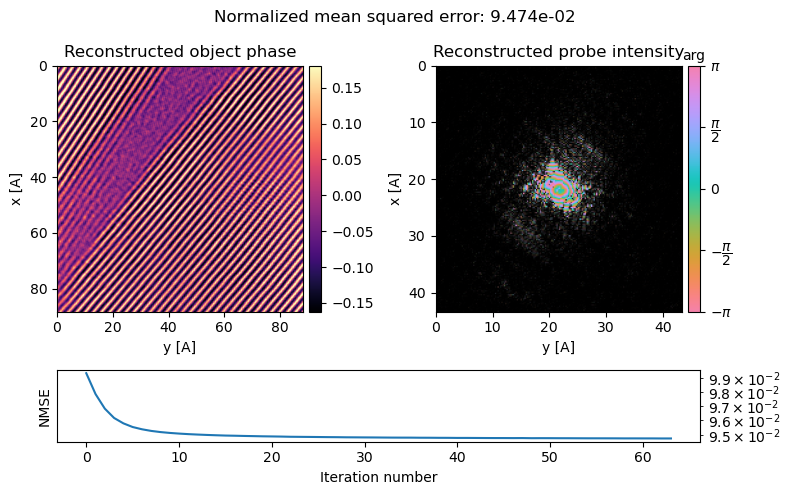

In [ ]:
ptycho_bad_defoc = py4DSTEM.process.phase.SingleslicePtychography(
    datacube=dataset_masked,
    energy=300e3,
    defocus=50,
    vacuum_probe_intensity=probe_nparray,
    verbose=True,
    device='gpu', # uncomment if you have access to a GPU
    storage='cpu', # uncomment if you have access to a GPU
).preprocess(
    plot_center_of_mass = True,
    plot_rotation=True,
    plot_probe_overlaps=True,
    vectorized_com_calculation = False, # disable default CoM vectorized calc
    store_initial_arrays= False, # don't store arrays necessary for reset=True
).reconstruct(
    num_iter = 64,
    seed_random=0,
    max_batch_size=512,
).visualize(
)

Calculating center of mass: 100%|██████████| 65536/65536 [00:19<00:00, 3345.53probe position/s]
Best fit rotation = -4 degrees.
Normalizing amplitudes: 100%|██████████| 65536/65536 [03:07<00:00, 349.99probe position/s]
Performing 64 iterations using a complex object type, with the gradient-descent algorithm, with normalization_min: 1 and step_size: 0.5, in batches of max 512 measurements.
Reconstructing object and probe: 100%|██████████| 64/64 [18:08<00:00, 17.01s/ iter]


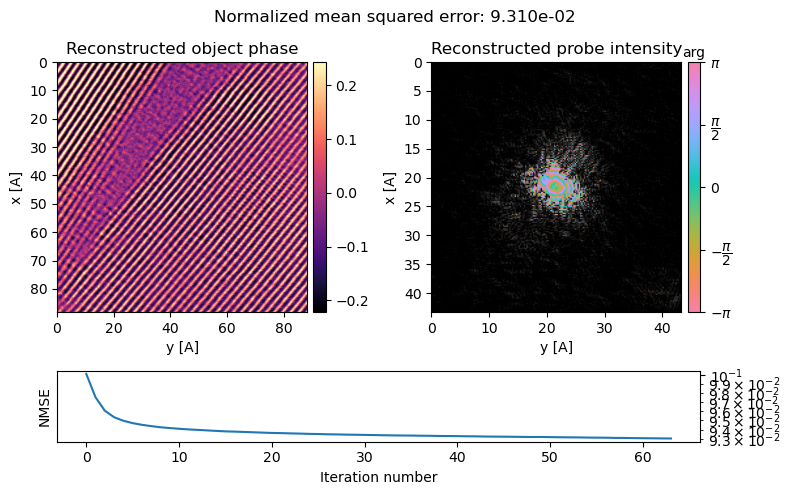

In [ ]:
mptycho_bad_Defoc = py4DSTEM.process.phase.MultislicePtychography(
    energy=300e3,
    num_slices=5,
    slice_thicknesses=10,
    datacube=dataset_masked,
    defocus=50,
    vacuum_probe_intensity=probe_nparray,
    verbose=True,
    device='gpu', # uncomment if you have access to a GPU
    storage='cpu', # uncomment if you have access to a GPU
).preprocess(
    plot_center_of_mass = False,
    plot_rotation=False,
    plot_probe_overlaps=False,
    vectorized_com_calculation = False, # disable default CoM vectorized calc
    store_initial_arrays= False, # don't store arrays necessary for reset=True
).reconstruct(
    num_iter = 64,
    seed_random=0,
    max_batch_size=512,
).visualize(
)

Calculating center of mass: 100%|██████████| 65536/65536 [00:19<00:00, 3337.93probe position/s]
Best fit rotation = -4 degrees.
Normalizing amplitudes: 100%|██████████| 65536/65536 [03:08<00:00, 347.66probe position/s]
Performing 64 iterations using a complex object type, with the gradient-descent algorithm, with normalization_min: 1 and step_size: 0.5, in batches of max 512 measurements.
Reconstructing object and probe: 100%|██████████| 64/64 [07:11<00:00,  6.74s/ iter]


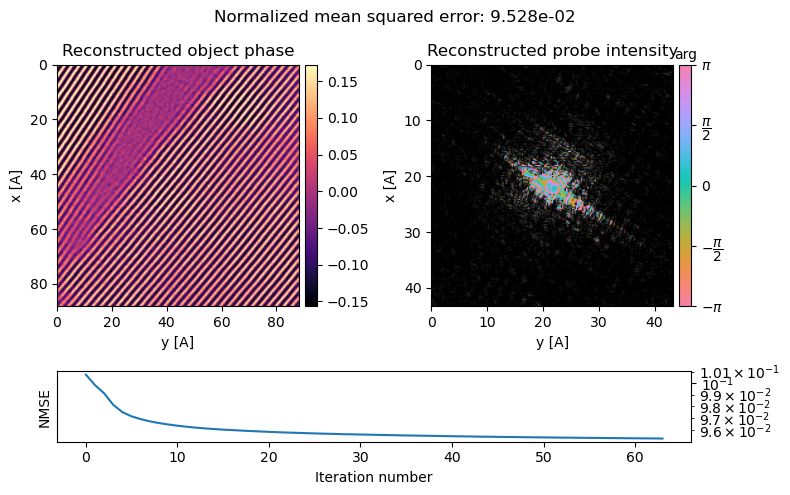

In [ ]:
ptycho_bad_defoc2 = py4DSTEM.process.phase.SingleslicePtychography(
    datacube=dataset_masked,
    energy=300e3,
    defocus=-50,
    vacuum_probe_intensity=probe_nparray,
    verbose=True,
    device='gpu', # uncomment if you have access to a GPU
    storage='cpu', # uncomment if you have access to a GPU
).preprocess(
    plot_center_of_mass = False,
    plot_rotation=False,
    plot_probe_overlaps=False,
    vectorized_com_calculation = False, # disable default CoM vectorized calc
    store_initial_arrays= False, # don't store arrays necessary for reset=True
).reconstruct(
    num_iter = 64,
    seed_random=0,
    max_batch_size=512,
).visualize(
)

Calculating center of mass: 100%|██████████| 65536/65536 [00:19<00:00, 3328.92probe position/s]
Best fit rotation = -4 degrees.
Normalizing amplitudes: 100%|██████████| 65536/65536 [03:26<00:00, 317.80probe position/s]
Performing 64 iterations using a complex object type, with the gradient-descent algorithm, with normalization_min: 1 and step_size: 0.5, in batches of max 512 measurements.
Reconstructing object and probe: 100%|██████████| 64/64 [18:09<00:00, 17.02s/ iter]


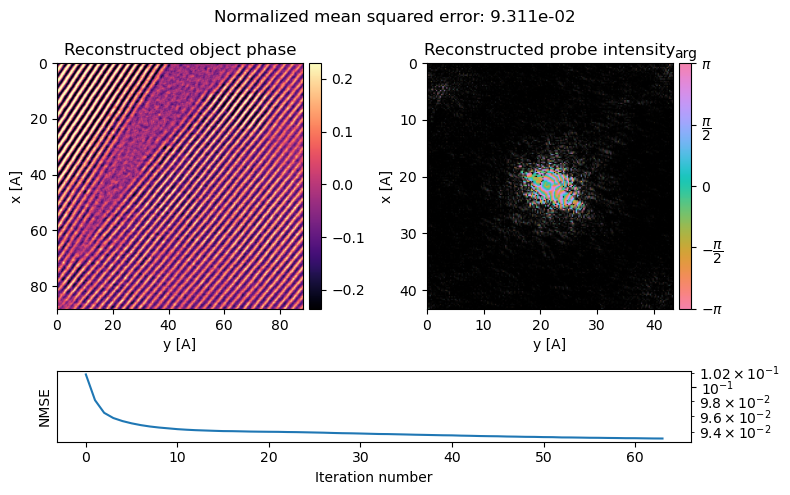

In [ ]:
mptycho_bad_Defoc2 = py4DSTEM.process.phase.MultislicePtychography(
    energy=300e3,
    num_slices=5,
    slice_thicknesses=50,
    datacube=dataset_masked,
    defocus=-50,
    vacuum_probe_intensity=probe_nparray,
    verbose=True,
    device='gpu', # uncomment if you have access to a GPU
    storage='cpu', # uncomment if you have access to a GPU
).preprocess(
    plot_center_of_mass = False,
    plot_rotation=False,
    plot_probe_overlaps=False,
    vectorized_com_calculation = False, # disable default CoM vectorized calc
    store_initial_arrays= False, # don't store arrays necessary for reset=True
).reconstruct(
    num_iter = 64,
    seed_random=0,
    max_batch_size=512,
).visualize(
)

In [ ]:
mptycho_thick_1 = py4DSTEM.process.phase.MultislicePtychography(
    energy=300e3,
    num_slices=6,
    slice_thicknesses=100,
    datacube=dataset_masked,
    defocus=0,
    vacuum_probe_intensity=probe_nparray,
    verbose=True,
    device='gpu', # uncomment if you have access to a GPU
    storage='cpu', # uncomment if you have access to a GPU
).preprocess(
    plot_center_of_mass = False,
    plot_rotation=False,
    plot_probe_overlaps=False,
    vectorized_com_calculation = False, # disable default CoM vectorized calc
    store_initial_arrays= False, # don't store arrays necessary for reset=True
    max_batch_size=512,
)

Calculating center of mass: 100%|██████████| 65536/65536 [00:19<00:00, 3353.78probe position/s]
Best fit rotation = -4 degrees.
Normalizing amplitudes: 100%|██████████| 65536/65536 [03:08<00:00, 346.89probe position/s]


Performing 64 iterations using a complex object type, with the gradient-descent algorithm, with normalization_min: 1 and step_size: 0.5, in batches of max 512 measurements.
Reconstructing object and probe: 100%|██████████| 64/64 [20:52<00:00, 19.57s/ iter]


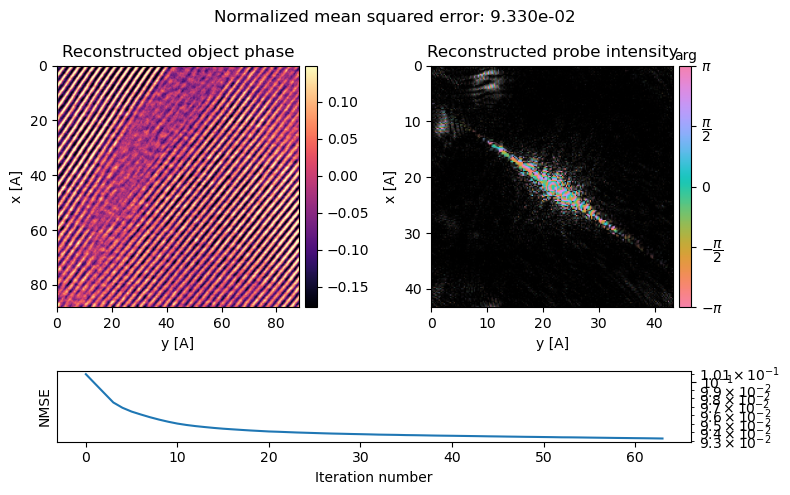

In [ ]:
mtycho_thick = mptycho_thick_1.reconstruct(
    num_iter = 64,
    seed_random=0,
    max_batch_size=512,
).visualize(
)

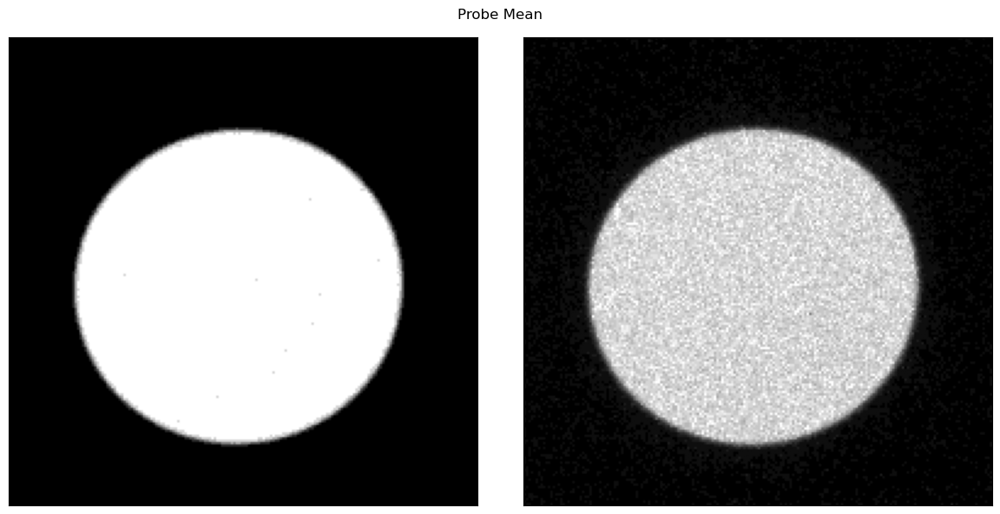

In [ ]:
py4DSTEM.show(
    [
        probe_nparray,
        probe_masked.tree('dp_max').data
    ],
    cmap='gray',
    figsize=(4,4),
    ticks=False,
    title='Probe Mean',
)

In [ ]:
raise SystemExit('End of script reached. No further processing will be done.')

SystemExit: End of script reached. No further processing will be done.

To exit: use 'exit', 'quit', or Ctrl-D.


Reconstructing object and probe: 100%|██████████████████████████████████████| 64/64 [00:37<00:00,  1.68 iter/s]


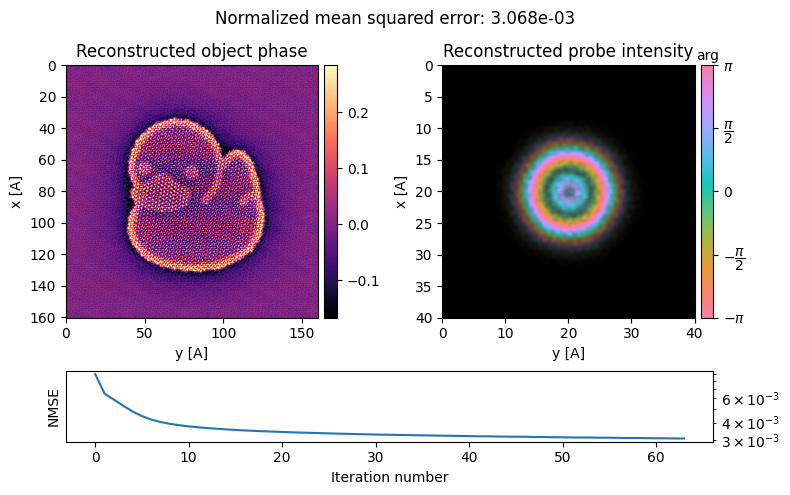

In [ ]:
ptycho_wrong_rotation = py4DSTEM.process.phase.SingleslicePtychography(
    datacube=dataset,
    energy=80e3,
    defocus=500,
    vacuum_probe_intensity=probe.data,
    verbose=False,
    device='gpu', # uncomment if you have access to a GPU
    storage='cpu', # uncomment if you have access to a GPU
).preprocess(
    plot_center_of_mass = False,
    force_com_rotation = -15*0.85,
    plot_probe_overlaps=False,
).reconstruct(
    num_iter = 64,
    seed_random=0,
    max_batch_size=512,
).visualize(
)

Reconstructing object and probe: 100%|██████████████████████████████████████| 64/64 [00:38<00:00,  1.68 iter/s]


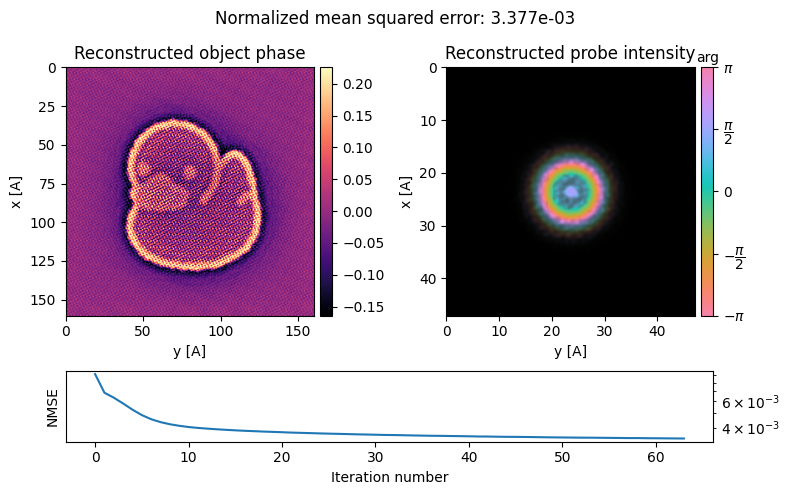

In [ ]:
ptycho_wrong_pixelsize = py4DSTEM.process.phase.SingleslicePtychography(
    datacube=dataset,
    energy=80e3,
    defocus=500,
    vacuum_probe_intensity=probe.data,
    verbose=False,
    device='gpu', # uncomment if you have access to a GPU
    storage='cpu', # uncomment if you have access to a GPU
).preprocess(
    force_reciprocal_sampling=0.025*0.85,
    plot_center_of_mass = False,
    plot_rotation=False,
    plot_probe_overlaps=False,
).reconstruct(
    num_iter = 64,
    seed_random=0,
    max_batch_size=512,
).visualize(
)

It's interesting to note how more sensitive some calibrations are over others, and how different the failure modes are!

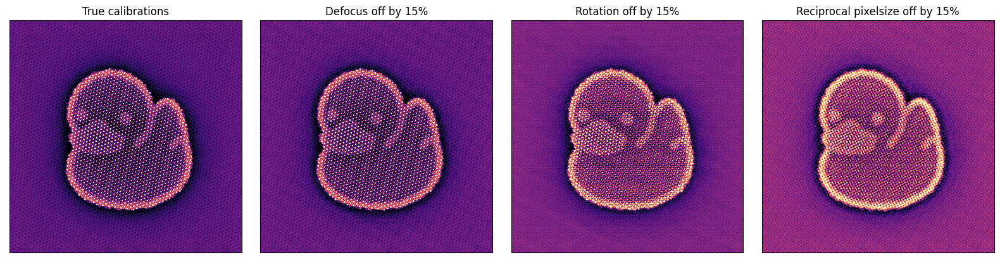

In [ ]:
py4DSTEM.show(
    [
        np.angle(ptycho.object_cropped),
        np.angle(ptycho_wrong_defocus.object_cropped),
        np.angle(ptycho_wrong_rotation.object_cropped),
        np.angle(ptycho_wrong_pixelsize.object_cropped),
    ],
    cmap='magma',
    ticks=False,
    title=["True calibrations","Defocus off by 15%","Rotation off by 15%","Reciprocal pixelsize off by 15%"],
    axsize=(4,4),
)

### Ptychography Optimizer & Optimization Parameter

As we've seen all ptychographic functions in py4DSTEM follow the framework:
```python
XxPtychography(
    **init_args
).preprocess
    **preprocess_args
).reconstruct(
    **reconstruction_args
)
```

The optimizer is thus built around this framework and accepts the ptychographic class as its first argument, followed by the init, preprocess, and reconstruction argument dictionaries
```python
PtychographyOptimizer(
    XxPtychography,
    init_args = init_args,
    preprocess_args = preprocess_args,
    reconstruction_args = reconstruction_args,
)
```

In each dictionary, parameters to be optimized are passed wrapped in an `OptimizationParameter` object, specified as 
```python
OptimizationParameter(
    initial_value,
    lower_bound,
    upper_bound,
)
```
`OptimizationParameter` assumes parameters are real numbers by default, but also supports boolean and integer arguments using the `space` keyword argument. 

Let's translate the ducky parameters to these dictionaries. We'll start with the reciprocal pixel-size, since it's so sensitive.

In [ ]:
from py4DSTEM.process.phase.parameter_optimize import OptimizationParameter, PtychographyOptimizer

init_args = {
    'datacube':dataset,
    'energy':80e3,
    'vacuum_probe_intensity':probe.data,
    'device':'gpu',
    'storage':'cpu',
    'defocus':500,
}

preprocess_args = {
    'force_reciprocal_sampling':OptimizationParameter(0.025,0.01,0.04),
    'force_com_rotation': -15,
    'force_com_transpose': False,
}

recon_args = {
    'num_iter':8,
    'max_batch_size':512,
}

optimizer = PtychographyOptimizer(
    py4DSTEM.process.phase.SingleslicePtychography,
    init_args = init_args,
    preprocess_args = preprocess_args,
    reconstruction_args = recon_args,
)

### Grid-search
The simplest optimization is to perform a grid-search. This ignores the `initial_value` argument of `OptimizationParameter` and instead evaluates the ptychography model using equally-distributed `n_points` between the `lower_bound` and `upper_bound`.

Searching parameters: 100%|██████████████████████████████████████████████████████| 5/5 [00:29<00:00,  5.98s/it]


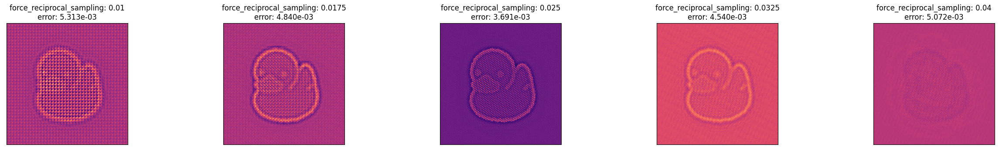

In [ ]:
optimizer.grid_search(
    n_points=(5,),
    error_metric="linear",
    plot_reconstructed_objects=True,
    return_reconstructed_objects=False,
    figsize=(25,6.5),
    ncols = 5,
)

We can see the true calibrations demonstrate a global minimum (although note we used a rather aggressive range).

### Bayesian-Optimization with Gaussian Processes

Alternatively, we can perform a more efficient search using Bayesian optimization with Gaussian processes (as implemented in [scikit-optimize](https://scikit-optimize.github.io/stable/)).

Optimizing parameters: 100%|███████████████████████████████████████████████████| 50/50 [05:05<00:00,  6.11s/it]


Optimized parameters:
force_reciprocal_sampling: 0.024364906834806424


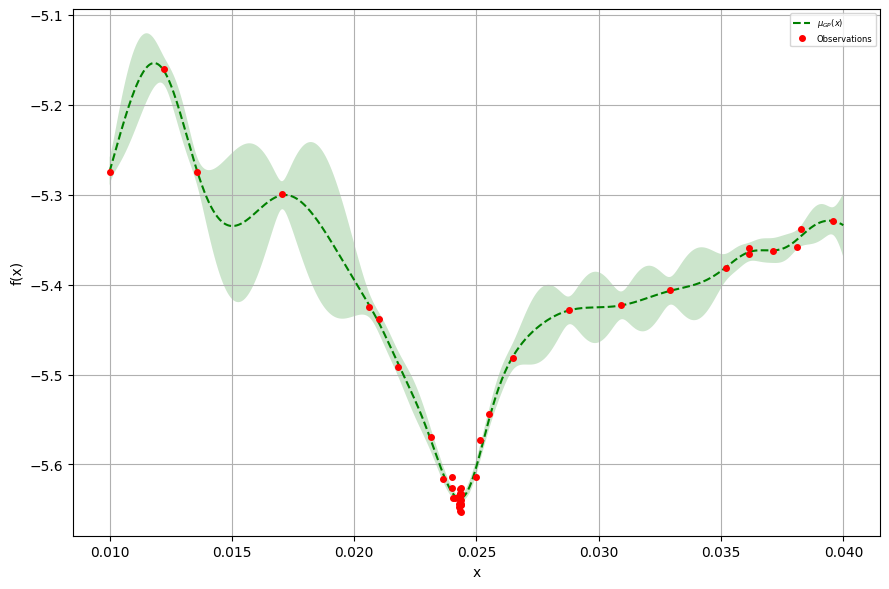

In [ ]:
optimizer.optimize(
    n_calls=50,
    n_initial_points=15,
    error_metric='log',
)
optimizer = optimizer.visualize()

We can also optimize more than one parameters at a time (although note this is not always advisable).  
Here, we optimize defocus and rotation jointly and plot the partial dependence of each parameter on the error metric.

Optimizing parameters: 100%|███████████████████████████████████████████████████| 50/50 [05:07<00:00,  6.16s/it]


Optimized parameters:
defocus: 470.548687501927
force_com_rotation: -15.733333088439176


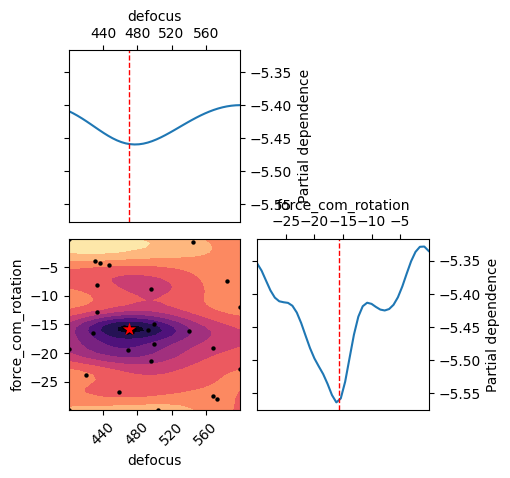

In [ ]:
# Replace/add Optimization parameters in the argument dictionaries
preprocess_args.pop('force_reciprocal_sampling',None)
init_args['defocus']=OptimizationParameter(500,400,600)
preprocess_args['force_com_rotation']=OptimizationParameter(-15,-30,0)

optimizer_defocus_rotation = PtychographyOptimizer(
    py4DSTEM.process.phase.SingleslicePtychography,
    init_args = init_args,
    preprocess_args = preprocess_args,
    reconstruction_args = recon_args,
)

optimizer_defocus_rotation.optimize(
    n_calls=50,
    n_initial_points=15,
    error_metric='log',
)
optimizer_defocus_rotation = optimizer_defocus_rotation.visualize()

Notice how the optimized result is not in-fact the true calibration of 500 A defocus!  
This highlights the risks of blindly using the self-consistency error as an optimization function. To remedy this, `optimize` function accepts an `error_metric` argument, with a variety of predefined and custom metrics.